<a href="https://colab.research.google.com/github/saadz-khan/StyleGAN-client/blob/master/StyleGAN_Encoder_Tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is pbaylies' StyleGAN Encoder and tutorial, ported to StyleGAN 2.
  
 * Note: make sure you're using the GPU runtime for this - see Runtime -> Change Runtime Type in Google Colab

In [1]:
!pip install --force tqdm==4.24.0

     |████████████████████████████████| 43 kB 911 kB/s 
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.62.3
    Uninstalling tqdm-4.62.3:
      Successfully uninstalled tqdm-4.62.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
spacy 2.2.4 requires tqdm<5.0.0,>=4.38.0, but you have tqdm 4.24.0 which is incompatible.
panel 0.12.1 requires tqdm>=4.48.0, but you have tqdm 4.24.0 which is incompatible.
fbprophet 0.7.1 requires tqdm>=4.36.1, but you have tqdm 4.24.0 which is incompatible.


First, clone the repo:

In [4]:
#!git clone https://github.com/robertluxemburg/stylegan2encoder
%cd stylegan2encoder

/content/stylegan2encoder


TODO: Optionally, try training a ResNet of your own if you like; this could take a while. Remember, there's a pre-trained model linked in the repo that works with the FFHQ faces StyleGAN model)

Next, let's get some test images to work with... These are from Pexels, which has free stock photos.

In [3]:
!mkdir aligned_images raw_images
#!wget -O raw_images/stock_photo1.jpg 'https://images.pexels.com/photos/614810/pexels-photo-614810.jpeg?auto=compress&cs=tinysrgb&dpr=3&h=1536&w=1536'
#!wget -O raw_images/stock_photo2.jpg 'https://images.pexels.com/photos/1445467/pexels-photo-1445467.jpeg?auto=compress&cs=tinysrgb&dpr=3&h=1536&w=1536'

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


/content/stylegan2encoder


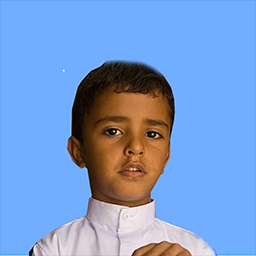

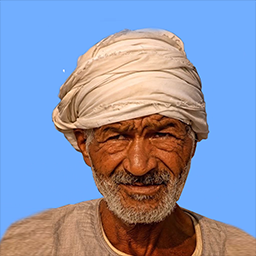

In [5]:
import PIL.Image
%cd /content/stylegan2encoder
img1 = PIL.Image.open('/content/drive/MyDrive/ulaa/data/front faces69.png')
wpercent = (256/float(img1.size[0]))
hsize = int((float(img1.size[1])*float(wpercent)))
img1 = img1.resize((256,hsize), PIL.Image.LANCZOS)
img2 = PIL.Image.open('/content/drive/MyDrive/ulaa/data/front faces39.png')
wpercent = (256/float(img2.size[0]))
hsize = int((float(img2.size[1])*float(wpercent)))
img2 = img2.resize((256,hsize), PIL.Image.LANCZOS)
display(img1, img2)

Now we need to get just the faces, cropped and aligned... fortunately, there's already a script for this!

In [6]:
!python align_images.py /content/drive/MyDrive/ulaa/data aligned_images/

Using TensorFlow backend.
64045056/64040097 [==============================] - 3s 0us/step


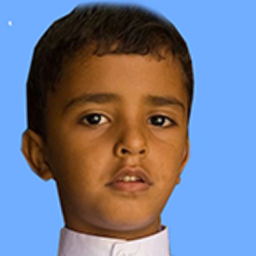

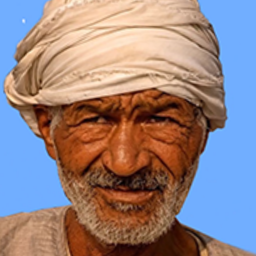

In [7]:
# Add one more (pre-aligned) image.
#!wget -O aligned_images/23.jpg https://rolux.org/media/stylegan/23.jpg

display(PIL.Image.open('/content/stylegan2encoder/aligned_images/front faces69_01.png').resize((256,256)))
display(PIL.Image.open('/content/stylegan2encoder/aligned_images/front faces39_01.png').resize((256,256)))
#display(PIL.Image.open('aligned_images/23.jpg').resize((256,256)))

Finally, let's try encoding some images into a latent representation! That's what you came here for, right? Let's just do a quick encoding, and see how we do...

In [8]:
!python encode_images.py aligned_images/ generated_images/ latent_representations/ \
    --vgg_url=https://rolux.org/media/stylegan/vgg16_zhang_perceptual.pkl \
    --batch_size=2

Using TensorFlow backend.
Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.
58892288/58889256 [==============================] - 1s 0us/step
  0% 0/1 [00:00<?, ?it/s]Loading mask masks/front faces39_01.png
Loading mask masks/front faces69_01.png
Loading mask masks/front faces39_01.png
Loading mask masks/front faces69_01.png

  0% 0/100 [00:00<?, ?it/s]Traceback (most recent call last):
  File "encode_images.py", line 243, in <module>
    main()
  File "encode_images.py", line 177, in main
    for loss_dict in pbar:
  File "/usr/local/lib/python3.7/dist-packages/tqdm/_tqdm.py", line 931, in __iter__
    for obj in iterable:
  File "/content/stylegan2encoder/encoder/perceptual_model.py", line 305, in optimize
    _, loss, lr = self.sess.run(fetch_ops)
  File "/tensorflow-1.15.2/python3.7/tensorflow_core/python/client/session.py", line 956, in run
    run_metadata_ptr)
  File 

Ok, let's see how we did! Note the paths above, the generated image is in the generated_images folder, the latent representation is in the latent_representations folder, and since we generated videos of the training process, by default those are in the videos folder.

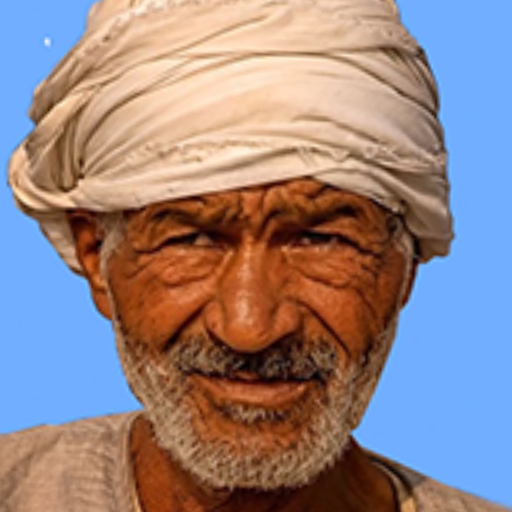

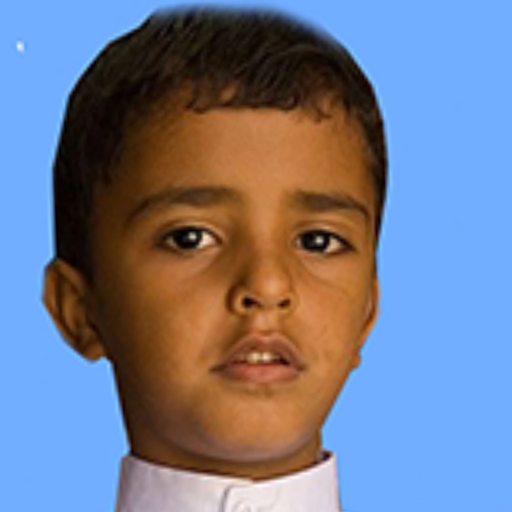

In [9]:
display(PIL.Image.open('/content/stylegan2encoder/aligned_images/front faces39_01.png').resize((512, 512)))
display(PIL.Image.open('/content/stylegan2encoder/aligned_images/front faces69_01.png').resize((512, 512)))
#display(PIL.Image.open('generated_images/23.png').resize((512, 512)))

Great job, everybody, nailed it! ... wait, what's that you say, the second image doesn't quite look the same? Hmm... let's try to do a better job, shall we?

In [10]:
#!mv aligned_images/stock_photo1_01.png aligned_images/_stock_photo1_01.png
#!mv generated_images/stock_photo2_01.png generated_images/_stock_photo2_01.png
#!mv generated_images/23.png generated_images/_23.png

!python encode_images.py aligned_images/ generated_images/ latent_representations/ \
    --vgg_url=https://rolux.org/media/stylegan/vgg16_zhang_perceptual.pkl \
    --lr=0.25 --iterations=1000 --use_l1_penalty=0.5

Using TensorFlow backend.
Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.
  0% 0/2 [00:00<?, ?it/s]Loading mask masks/front faces39_01.png
Loading mask masks/front faces39_01.png

  0% 0/1000 [00:00<?, ?it/s]
front faces39_01: loss 231.6403; lr 0.2500:   0% 0/1000 [00:14<?, ?it/s]
front faces39_01: loss 231.6403; lr 0.2500:   0% 1/1000 [00:14<4:01:29, 14.50s/it]
front faces39_01: loss 222.2261; lr 0.2500:   0% 1/1000 [00:15<4:19:40, 15.60s/it]
front faces39_01: loss 222.2261; lr 0.2500:   0% 2/1000 [00:15<2:09:44,  7.80s/it]
front faces39_01: loss 213.8710; lr 0.2500:   0% 2/1000 [00:16<2:18:52,  8.35s/it]
front faces39_01: loss 213.8710; lr 0.2500:   0% 3/1000 [00:16<1:32:30,  5.57s/it]
front faces39_01: loss 205.5246; lr 0.2500:   0% 3/1000 [00:17<1:38:34,  5.93s/it]
front faces39_01: loss 205.5246; lr 0.2500:   0% 4/1000 [00:17<1:13:51,  4.45s/it]
front faces39_01: los

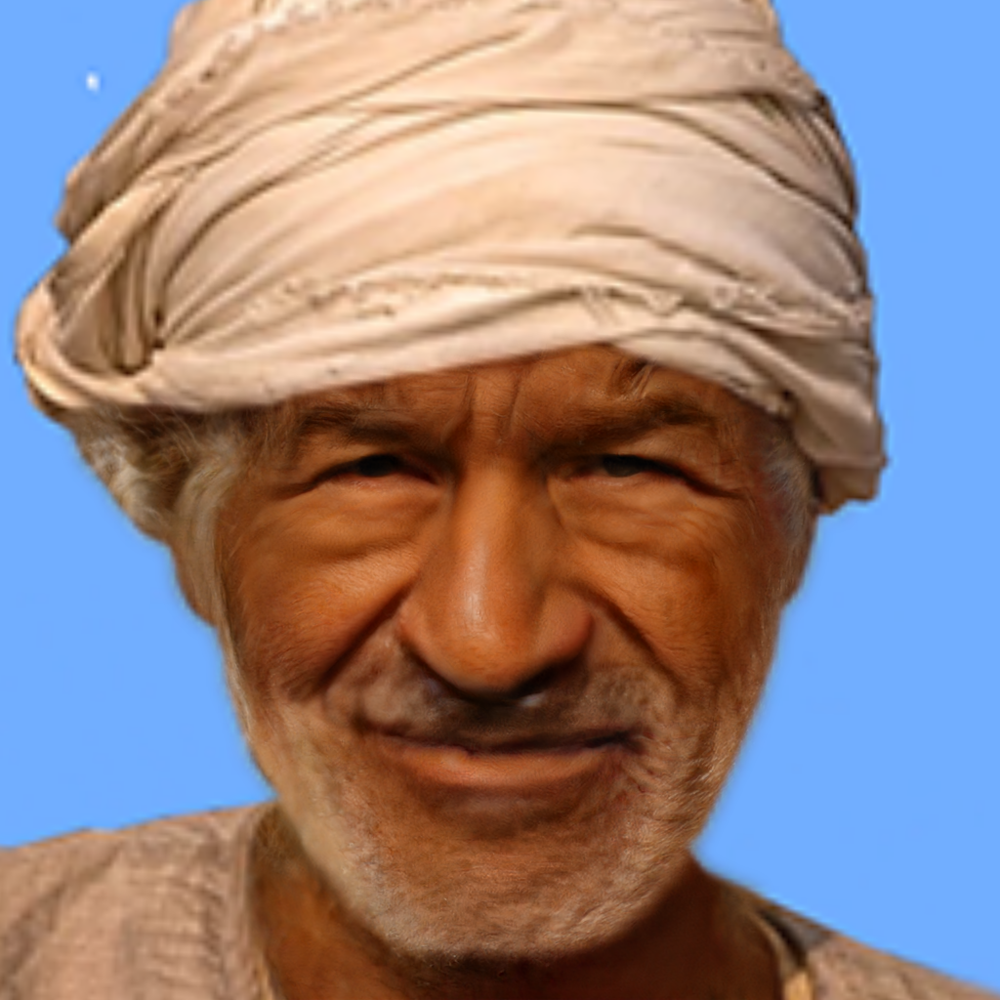

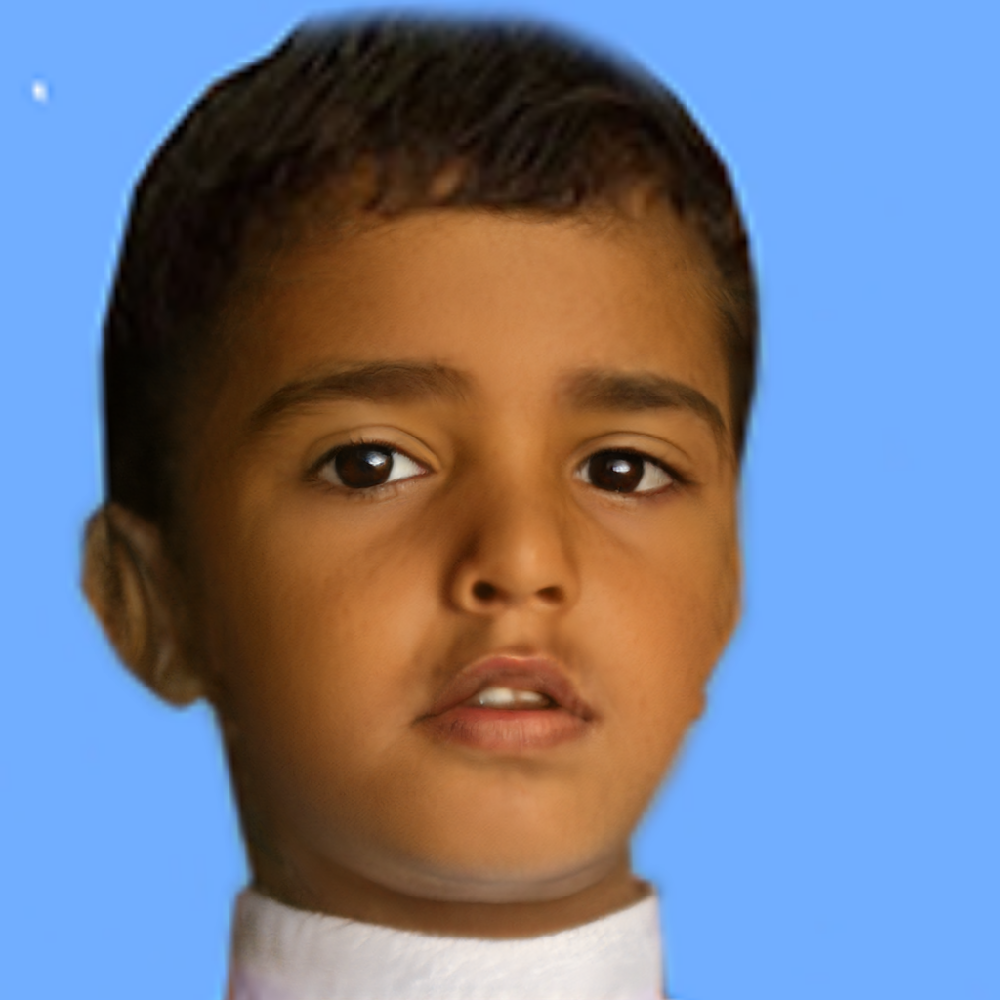

In [13]:
display(PIL.Image.open('generated_images/front faces39_01.png'))
display(PIL.Image.open('generated_images/front faces69_01.png'))

When in doubt, mess with the parameters... here, we ~lowered the l1 penalty on the dlatents, to allow for greater variation outside of what StyleGAN knows well, and we've lowered the learning rate and~ raised the number of iterations~, to allow for more gradual changes~. See more options below:

In [ ]:
!python encode_images.py --help

Using TensorFlow backend.
usage: encode_images.py [-h] [--data_dir DATA_DIR] [--mask_dir MASK_DIR]
                        [--load_last LOAD_LAST] [--dlatent_avg DLATENT_AVG]
                        [--model_url MODEL_URL] [--model_res MODEL_RES]
                        [--batch_size BATCH_SIZE] [--optimizer OPTIMIZER]
                        [--vgg_url VGG_URL] [--image_size IMAGE_SIZE]
                        [--resnet_image_size RESNET_IMAGE_SIZE] [--lr LR]
                        [--decay_rate DECAY_RATE] [--iterations ITERATIONS]
                        [--decay_steps DECAY_STEPS]
                        [--early_stopping [EARLY_STOPPING]]
                        [--early_stopping_threshold EARLY_STOPPING_THRESHOLD]
                        [--early_stopping_patience EARLY_STOPPING_PATIENCE]
                        [--load_effnet LOAD_EFFNET]
                        [--load_resnet LOAD_RESNET]
                        [--use_preprocess_input [USE_PREPROCESS_INPUT]]
                 

## ~ Here Be Dragons ~

Ok, that's nice, but what to do with the latents? Well, I'm glad you asked, let's see what we can do with the two latent representations we now have to rub together...

In [15]:
!pip install config

In [16]:
!rm -rf /content/drive/MyDrive/ulaa/stylegan-encoder
!rm -rf /content/drive/MyDrive/ulaa/stylegan2

In [15]:
import numpy as np
import config
import dnnlib
import dnnlib.tflib as tflib
import pickle
import PIL.Image
# load the StyleGAN model into Colab
URL_FFHQ = 'https://drive.google.com/uc?id=1Wy8AbGsBRUn9g33rbK3HO3e-WmNajfpv'
tflib.init_tf()
with dnnlib.util.open_url(URL_FFHQ, cache_dir=config.cache_dir) as f:
    generator_network, discriminator_network, Gs_network = pickle.load(f)
# load the latents
s1 = np.load('latent_representations/front faces39_01.npy')
s2 = np.load('latent_representations/front faces39_01.npy')
s1 = np.expand_dims(s1,axis=0)
s2 = np.expand_dims(s2,axis=0)
# combine the latents somehow... let's try an average:
savg = 0.5*(s1+s2)
# run the generator network to render the latents:
synthesis_kwargs = dict(output_transform=dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=False), minibatch_size=8)
images = Gs_network.components.synthesis.run(savg, randomize_noise=False, **synthesis_kwargs)
display(PIL.Image.fromarray(images.transpose((0,2,3,1))[0], 'RGB').resize((512,512),PIL.Image.LANCZOS))

AttributeError: ignored

Ok, that looks complicated. Can we do it again, but simpler? Sure. (Restart the runtime if it gives you trouble...)

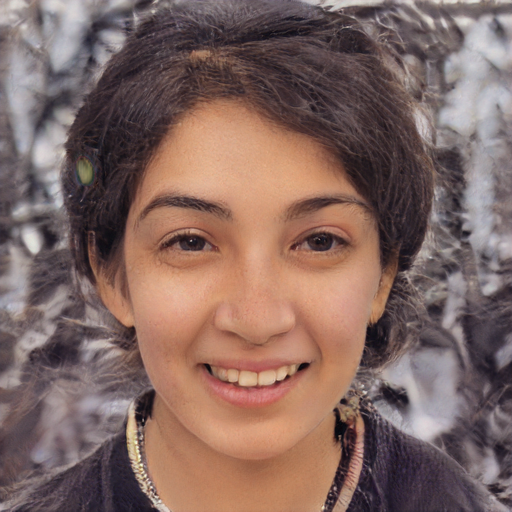

In [16]:
import math
import pickle
import PIL.Image
import numpy as np
import config
import dnnlib
import dnnlib.tflib as tflib
from encoder.generator_model import Generator
URL_FFHQ = 'https://drive.google.com/uc?id=1Wy8AbGsBRUn9g33rbK3HO3e-WmNajfpv'
tflib.init_tf()
with dnnlib.util.open_url(URL_FFHQ) as f:
    generator_network, discriminator_network, Gs_network = pickle.load(f)

generator = Generator(Gs_network, batch_size=1, randomize_noise=False)

model_res = 1024
model_scale = int(2*(math.log(model_res,2)-1))

def generate_raw_image(latent_vector):
    latent_vector = latent_vector.reshape((1, model_scale, 512))
    generator.set_dlatents(latent_vector)
    return generator.generate_images()[0]

def generate_image(latent_vector):
    img_array = generate_raw_image(latent_vector)
    img = PIL.Image.fromarray(img_array, 'RGB')
    return img

s1 = np.load('latent_representations/front faces39_01.npy')
s2 = np.load('latent_representations/front faces39_01.npy')
s1 = np.expand_dims(s1,axis=0)
s2 = np.expand_dims(s2,axis=0)

display(generate_image(0.3*s1+0.7*s2).resize((512,512),PIL.Image.LANCZOS))

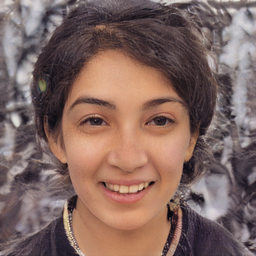

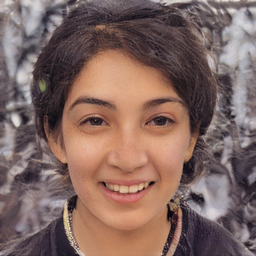

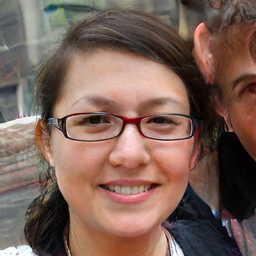

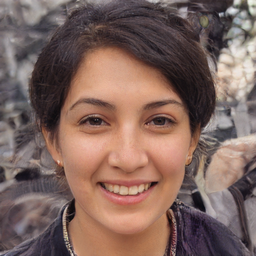

In [17]:
# more stupid latent tricks
lr = ((np.arange(1,model_scale+1)/model_scale)**0.75).reshape((model_scale,1))
rl = 1-lr
display(generate_image(lr*s1+rl*s2).resize((256,256),PIL.Image.LANCZOS))

lr = ((np.arange(1,model_scale+1)/model_scale)**0.25).reshape((model_scale,1))
rl = 1-lr
display(generate_image(lr*s2+rl*s1).resize((256,256),PIL.Image.LANCZOS))

display(generate_image(-0.5*s1).resize((256,256),PIL.Image.LANCZOS))
display(generate_image(-0.5*s1+(lr*s2+rl*s1)).resize((256,256),PIL.Image.LANCZOS))

# StyleGAN2

This notebook demonstrates how to run NVIDIA's StyleGAN2 on Google Colab.
Make sure to specify a GPU runtime.

This notebook mainly adds a few convenience functions for training and visualization. 

For information on StyleGAN2, see:

Paper: https://arxiv.org/abs/1812.04948

Video: https://youtu.be/kSLJriaOumA

Code: https://github.com/NVlabs/stylegan

FFHQ: https://github.com/NVlabs/ffhq-dataset

/Parth Suresh, 2020 + Mikael Christensen, 2019


In [18]:
%tensorflow_version 1.x
import tensorflow as tf

# Download the code
%cd content
!git clone https://github.com/NVlabs/stylegan2.git
%cd stylegan2
!nvcc test_nvcc.cu -o test_nvcc -run

print('Tensorflow version: {}'.format(tf.__version__) )
!nvidia-smi -L
print('GPU Identified at: {}'.format(tf.test.gpu_device_name()))

[Errno 2] No such file or directory: 'content'
/content/stylegan2encoder
Cloning into 'stylegan2'...
remote: Enumerating objects: 138, done.
remote: Counting objects: 100% (11/11), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 138 (delta 4), reused 10 (delta 4), pack-reused 127
Receiving objects: 100% (138/138), 599.47 KiB | 5.71 MiB/s, done.
Resolving deltas: 100% (62/62), done.
/content/stylegan2encoder/stylegan2
CPU says hello.
cudaErrorNoKernelImageForDevice: no kernel image is available for execution on the device
Tensorflow version: 1.15.2
GPU 0: Tesla K80 (UUID: GPU-eb5a0af8-7363-6a80-1da0-962fcb38a404)
GPU Identified at: /device:GPU:0


Connecting to our google drive.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Loading pretrained net

In [19]:
%cd /content/stylegan2/

/content/stylegan2encoder/stylegan2


In [20]:
# Download the model of choice  
import argparse
import numpy as np
import PIL.Image
import dnnlib
import dnnlib.tflib as tflib
import re
import sys
from io import BytesIO
import IPython.display
import numpy as np
from math import ceil
from PIL import Image, ImageDraw
import imageio

import pretrained_networks

# Choose between these pretrained models - I think 'f' is the best choice:

# 1024×1024 faces
# stylegan2-ffhq-config-a.pkl
# stylegan2-ffhq-config-b.pkl
# stylegan2-ffhq-config-c.pkl
# stylegan2-ffhq-config-d.pkl
# stylegan2-ffhq-config-e.pkl
# stylegan2-ffhq-config-f.pkl

# 512×384 cars
# stylegan2-car-config-a.pkl
# stylegan2-car-config-b.pkl
# stylegan2-car-config-c.pkl
# stylegan2-car-config-d.pkl
# stylegan2-car-config-e.pkl
# stylegan2-car-config-f.pkl

# 256x256 horses
# stylegan2-horse-config-a.pkl
# stylegan2-horse-config-f.pkl

# 256x256 churches
# stylegan2-church-config-a.pkl
# stylegan2-church-config-f.pkl

# 256x256 cats
# stylegan2-cat-config-f.pkl
# stylegan2-cat-config-a.pkl

#network_pkl = "/content/stylegan2-cat-config-f.pkl"

network_pkl = "https://drive.google.com/uc?id=1Wy8AbGsBRUn9g33rbK3HO3e-WmNajfpv" #Stylegan2 faces 256x256

# If downloads fails, due to 'Google Drive download quota exceeded' you can try downloading manually from your own Google Drive account
# network_pkl = "/content/drive/My Drive/GAN/stylegan2-ffhq-config-f.pkl"

print('Loading networks from "%s"...' % network_pkl)
_G, _D, Gs = pretrained_networks.load_networks(network_pkl)
noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]

Gs_kwargs = dnnlib.EasyDict()
Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
Gs_kwargs.randomize_noise = False

Loading networks from "https://drive.google.com/uc?id=1Wy8AbGsBRUn9g33rbK3HO3e-WmNajfpv"...


## Useful utility functions...

In [21]:
# Useful utility functions...

# Generates a list of images, based on a list of latent vectors (Z), and a list (or a single constant) of truncation_psi's.
def generate_images_in_w_space(dlatents, truncation_psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    Gs_kwargs.truncation_psi = truncation_psi
    dlatent_avg = Gs.get_var('dlatent_avg') # [component]

    imgs = []
    for row, dlatent in log_progress(enumerate(dlatents), name = "Generating images"):
        #row_dlatents = (dlatent[np.newaxis] - dlatent_avg) * np.reshape(truncation_psi, [-1, 1, 1]) + dlatent_avg
        dl = (dlatent-dlatent_avg)*truncation_psi   + dlatent_avg
        row_images = Gs.components.synthesis.run(dlatent,  **Gs_kwargs)
        imgs.append(PIL.Image.fromarray(row_images[0], 'RGB'))
    return imgs       

def generate_images(zs, truncation_psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    if not isinstance(truncation_psi, list):
        truncation_psi = [truncation_psi] * len(zs)
        
    imgs = []
    for z_idx, z in log_progress(enumerate(zs), size = len(zs), name = "Generating images"):
        Gs_kwargs.truncation_psi = truncation_psi[z_idx]
        noise_rnd = np.random.RandomState(1) # fix noise
        tflib.set_vars({var: noise_rnd.randn(*var.shape.as_list()) for var in noise_vars}) # [height, width]
        images = Gs.run(z, None, **Gs_kwargs) # [minibatch, height, width, channel]
        imgs.append(PIL.Image.fromarray(images[0], 'RGB'))
    return imgs

def generate_zs_from_seeds(seeds):
    zs = []
    for seed_idx, seed in enumerate(seeds):
        rnd = np.random.RandomState(seed)
        z = rnd.randn(1, *Gs.input_shape[1:]) # [minibatch, component]
        zs.append(z)
    return zs

# Generates a list of images, based on a list of seed for latent vectors (Z), and a list (or a single constant) of truncation_psi's.
def generate_images_from_seeds(seeds, truncation_psi):
    return generate_images(generate_zs_from_seeds(seeds), truncation_psi)

def saveImgs(imgs, location):
  for idx, img in log_progress(enumerate(imgs), size = len(imgs), name="Saving images"):
    file = location+ str(idx) + ".png"
    img.save(file)

def imshow(a, format='png', jpeg_fallback=True):
  a = np.asarray(a, dtype=np.uint8)
  str_file = BytesIO()
  PIL.Image.fromarray(a).save(str_file, format)
  im_data = str_file.getvalue()
  try:
    disp = IPython.display.display(IPython.display.Image(im_data))
  except IOError:
    if jpeg_fallback and format != 'jpeg':
      print ('Warning: image was too large to display in format "{}"; '
             'trying jpeg instead.').format(format)
      return imshow(a, format='jpeg')
    else:
      raise
  return disp

def showarray(a, fmt='png'):
    a = np.uint8(a)
    f = StringIO()
    PIL.Image.fromarray(a).save(f, fmt)
    IPython.display.display(IPython.display.Image(data=f.getvalue()))

        
def clamp(x, minimum, maximum):
    return max(minimum, min(x, maximum))
    
def drawLatent(image,latents,x,y,x2,y2, color=(255,0,0,100)):
  buffer = PIL.Image.new('RGBA', image.size, (0,0,0,0))
   
  draw = ImageDraw.Draw(buffer)
  cy = (y+y2)/2
  draw.rectangle([x,y,x2,y2],fill=(255,255,255,180), outline=(0,0,0,180))
  for i in range(len(latents)):
    mx = x + (x2-x)*(float(i)/len(latents))
    h = (y2-y)*latents[i]*0.1
    h = clamp(h,cy-y2,y2-cy)
    draw.line((mx,cy,mx,cy+h),fill=color)
  return PIL.Image.alpha_composite(image,buffer)
             
  
def createImageGrid(images, scale=0.25, rows=1):
   w,h = images[0].size
   w = int(w*scale)
   h = int(h*scale)
   height = rows*h
   cols = ceil(len(images) / rows)
   width = cols*w
   canvas = PIL.Image.new('RGBA', (width,height), 'white')
   for i,img in enumerate(images):
     img = img.resize((w,h), PIL.Image.ANTIALIAS)
     canvas.paste(img, (w*(i % cols), h*(i // cols))) 
   return canvas

def convertZtoW(latent, truncation_psi=0.7, truncation_cutoff=9):
  dlatent = Gs.components.mapping.run(latent, None) # [seed, layer, component]
  dlatent_avg = Gs.get_var('dlatent_avg') # [component]
  for i in range(truncation_cutoff):
    dlatent[0][i] = (dlatent[0][i]-dlatent_avg)*truncation_psi + dlatent_avg
    
  return dlatent

def interpolate(zs, steps):
   out = []
   for i in range(len(zs)-1):
    for index in range(steps):
     fraction = index/float(steps) 
     out.append(zs[i+1]*fraction + zs[i]*(1-fraction))
   return out

# Taken from https://github.com/alexanderkuk/log-progress
def log_progress(sequence, every=1, size=None, name='Items'):
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = int(size / 200)     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{name}: {index} / ?'.format(
                        name=name,
                        index=index
                    )
                else:
                    progress.value = index
                    label.value = u'{name}: {index} / {size}'.format(
                        name=name,
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = "{name}: {index}".format(
            name=name,
            index=str(index or '?')
        )



### Generate random Image

[3354950 9744701 6022900 6656638  571125 6600094 2725035  625649 8056897
 1762913 5597655 9271908  716468 5416514 3725839]


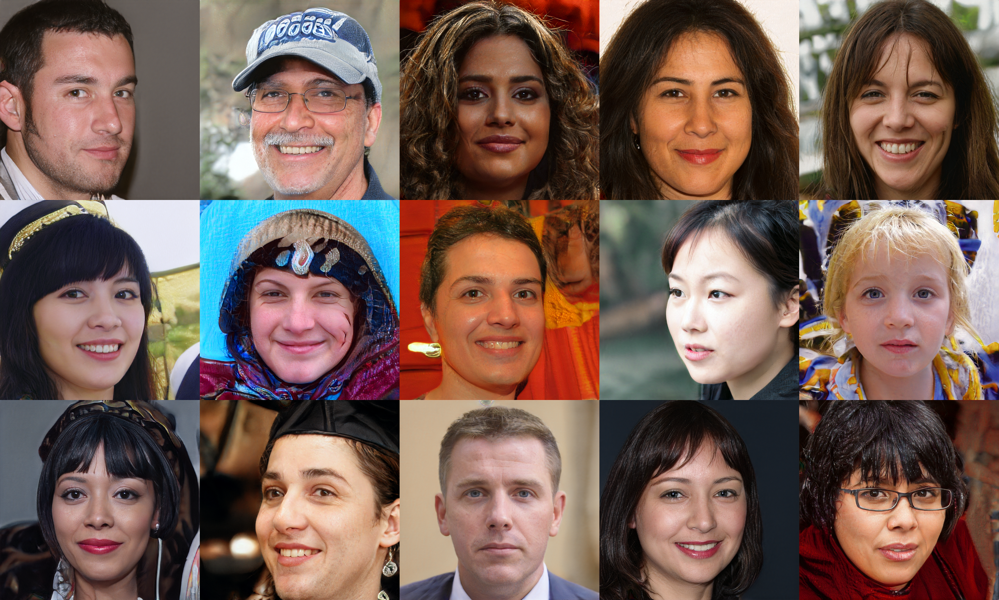

In [22]:
# generate some random seeds
seeds = np.random.randint(10000000, size=15)
print(seeds)

# show the seeds
imshow(createImageGrid(generate_images_from_seeds(seeds, 0.7), 0.7 , 3))

### Perform Interpolation

In [ ]:
!git clone https://github.com/Puzer/stylegan-encoder

In [ ]:
%cd /content/stylegan-encoder
!python encode_images.py /content/drive/MyDrive/ulaa/data /content/drive/MyDrive/ulaa/generated /content/drive/MyDrive/ulaa/latents

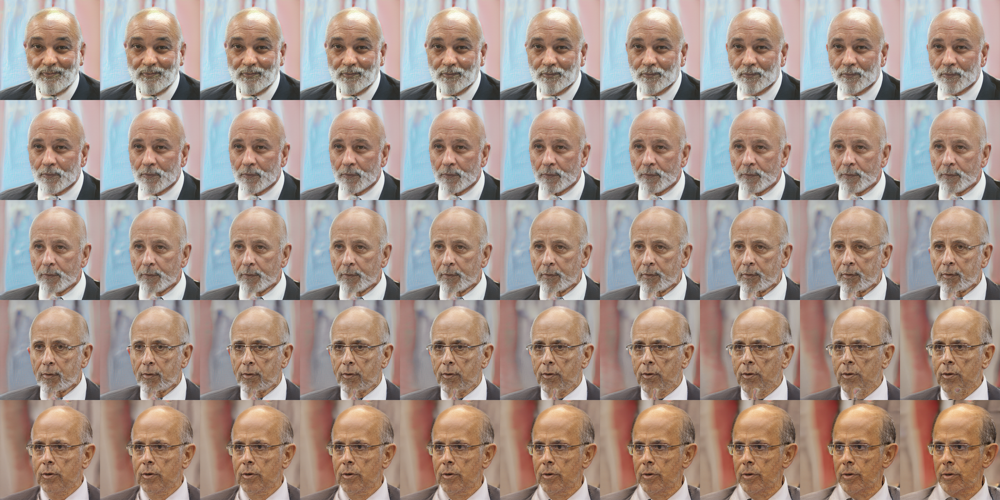

In [29]:
# Simple (Z) interpolation
#zs = generate_zs_from_seeds([9016907 , 1678600])
import numpy as np

latent2 = np.load('/content/stylegan2encoder/latent_representations/front faces69_01.npy')
latent1 = np.load('/content/stylegan2encoder/latent_representations/front faces39_01.npy')

number_of_steps = 50

imgs = generate_images(interpolate([latent1,latent2],number_of_steps), 1.0)
number_of_images = len(imgs)
imshow(createImageGrid(imgs, 0.4 , 5))